In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install kaggle


In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"phungtuhieu","key":"d5fcdccf19c397c2e95c149197d4acb5"}'}

In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d ashuguptahere/video-classification-ucf11

 99% 352M/354M [00:12<00:00, 24.1MB/s]
100% 354M/354M [00:12<00:00, 29.6MB/s]


In [ ]:
!unzip video-classification-ucf11.zip -d '/content/drive/MyDrive/ViT'

In [ ]:
!pip install datasets transformers
!pip install accelerate -U

drive_path = "/content/drive/MyDrive/ViT"


In [ ]:
# !rm -r "/content/drive/MyDrive/ViT/train"

In [ ]:
# @title Chỉ lấy 3 hành động
# import os
# import shutil

# # Đường dẫn của thư mục gốc
# source_directory = "/content/drive/MyDrive/ViT/training_set"

# # Đường dẫn của thư mục đích
# destination_directory = "/content/drive/MyDrive/ViT/train"

# # Danh sách tên thư mục bạn muốn sao chép
# desired_folders = ["biking", "soccer_juggling", "volleyball_spiking"]

# # Lặp qua các thư mục con trong thư mục gốc
# for root, dirs, files in os.walk(source_directory):
#     for dir_name in dirs:
#         if dir_name in desired_folders:
#             source_path = os.path.join(root, dir_name)
#             destination_path = os.path.join(destination_directory, dir_name)
#             print(dir_name)
#             shutil.copytree(source_path, destination_path)

biking
soccer_juggling
volleyball_spiking


Các tài liệu tham khảo:

 - Github: [Fine-tuning the Vision Transformer on CIFAR-10 with the 🤗 Trainer](https://github.com/NielsRogge/Transformers-Tutorials/blob/master/VisionTransformer/Fine_tuning_the_Vision_Transformer_on_CIFAR_10_with_the_%F0%9F%A4%97_Trainer.ipynb
)

- Bài viết trên trang chính thức của Hugging Face về cách tinh chỉnh mô hình Vision Transformer: [Fine-tune a pretrained ViT model](https://huggingface.co/blog/fine-tune-vit)

- [Tài liệu về các chuyển đổi hình ảnh trong PyTorch Vision](https://pytorch.org/vision/stable/transforms.html)

- [Ví dụ về các chuyển đổi hình ảnh trong PyTorch Vision](https://pytorch.org/vision/stable/auto_examples/transforms/plot_transforms_illustrations.html#sphx-glr-auto-examples-transforms-plot-transforms-illustrations-py
)

- [Tài liệu chính thức về mô hình Vision Transformer trong Transformers của Hugging Face](https://huggingface.co/docs/transformers/model_doc/vit
)

- [Kaggle Dataset về phân loại video UCF11](https://www.kaggle.com/datasets/ashuguptahere/video-classification-ucf11)

In [ ]:
# @title Load Dataset
from transformers import ViTImageProcessor
from datasets import load_dataset
train_path = drive_path + "/train"

# Load dữ liệu, ucf11 với 3 class biking, soccer_juggling, volleyball_spiking

train_ds = load_dataset("imagefolder", data_dir=train_path)
def split_dataset(dataset, train_ratio=0.6):


  train_size = int(train_ratio * dataset["train"].num_rows)
  val_size = dataset["train"].num_rows - train_size
  print(dataset["train"])
  train_ds = dataset["train"].select(range(train_size))
  val_ds = dataset["train"].select(range(train_size, train_size + val_size))
  return train_ds, val_ds

Resolving data files:   0%|          | 0/4500 [00:00<?, ?it/s]

Extracting data files: 0it [00:00, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

In [ ]:
# @title Chia dữ liệu và tạo label
train_ds, val_ds = split_dataset(train_ds, train_ratio=0.8)
# train_ds = train_ds["train"]
id2label = {id:label for id, label in enumerate(train_ds.features['label'].names)}
label2id = {label:id for id,label in id2label.items()}
# id2label


In [ ]:
# !rm -r "/content/drive/MyDrive/ViT/training_set"
# !rm -r "/content/drive/MyDrive/ViT/testing_set"
print(val_ds)
print(train_ds)

Dataset({
    features: ['image', 'label'],
    num_rows: 900
})
Dataset({
    features: ['image', 'label'],
    num_rows: 3600
})


In [ ]:
# @title Lưu label
import pickle
drive_path = "/content/drive/MyDrive/ViT"

# Lưu id2label
with open(drive_path + '/label/id2label.pkl', 'wb') as file:
    pickle.dump(id2label, file)

# Lưu label2id
with open(drive_path + '/label/label2id.pkl', 'wb') as file:
    pickle.dump(label2id, file)

In [ ]:
# @title Tiền xử lí hình ảnh
model_name = "google/vit-base-patch16-224"
# model_name = "google/vit-base-patch16-224-in21k"
processor = ViTImageProcessor.from_pretrained(model_name)
image_mean, image_std = processor.image_mean, processor.image_std
size = processor.size["height"]
from torchvision.transforms import v2
augmix = v2.AugMix(severity=2, mixture_width=2, chain_depth=-1, alpha=1.0, all_ops=True)

# Define additional data augmentations
additional_transforms = v2.Compose(
    [
        v2.RandomCrop(size, padding=4),
        v2.RandomVerticalFlip(p=0.5),
        v2.RandomEqualize(p=0.5),
        v2.RandomInvert(p=0.5),
        v2.ColorJitter(brightness=0.05, contrast=0.05, saturation=0.05, hue=0.25),
        v2.RandomPerspective(distortion_scale=0.4, p=1.0),
        v2.RandomRotation(degrees=(0, 20)),
        # v2.RandomZoomOut(side_range=(1.0, 4.0)),
        v2.AutoAugment(policy=v2.AutoAugmentPolicy.IMAGENET),
        v2.RandAugment(num_ops=1, magnitude=5),
        augmix,
    ]
)
image_mean, image_std = processor.image_mean, processor.image_std
size = processor.size["height"]

normalize = v2.Normalize(mean=image_mean, std=image_std)
_train_transforms = v2.Compose(
        [
            v2.ToTensor(),
            v2.ToDtype(torch.float32, scale=True),
            v2.RandomResizedCrop(size, scale=(0.8, 1.0), antialias=True),
            v2.RandomHorizontalFlip(p=0.5),
            additional_transforms,
            normalize,

        ]
    )

_val_transforms = v2.Compose(
        [
            v2.Resize(size, antialias=True),
            v2.CenterCrop(size),
            v2.ToTensor(),
            normalize,
        ]
    )


# Apply the transforms
def train_transforms(examples):
    examples["pixel_values"] = [
        _train_transforms(image.convert("RGB"))
        for image in examples["image" ]
    ]
    return examples

def val_transforms(examples):
    examples["pixel_values"] = [_val_transforms(image.convert("RGB")) for image in examples["image"]]
    return examples

# train_ds["train"]
# Set the transforms
train_ds.set_transform(train_transforms)
val_ds.set_transform(val_transforms)

train_ds[:2]

{'image': [<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=320x240>,
  <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=320x240>],
 'label': [0, 0],
 'pixel_values': [tensor([[[-1., -1., -1.,  ..., -1., -1., -1.],
           [-1., -1., -1.,  ..., -1., -1., -1.],
           [-1., -1., -1.,  ..., -1., -1., -1.],
           ...,
           [-1., -1., -1.,  ..., -1., -1., -1.],
           [-1., -1., -1.,  ..., -1., -1., -1.],
           [-1., -1., -1.,  ..., -1., -1., -1.]],
  
          [[-1., -1., -1.,  ..., -1., -1., -1.],
           [-1., -1., -1.,  ..., -1., -1., -1.],
           [-1., -1., -1.,  ..., -1., -1., -1.],
           ...,
           [-1., -1., -1.,  ..., -1., -1., -1.],
           [-1., -1., -1.,  ..., -1., -1., -1.],
           [-1., -1., -1.,  ..., -1., -1., -1.]],
  
          [[-1., -1., -1.,  ..., -1., -1., -1.],
           [-1., -1., -1.,  ..., -1., -1., -1.],
           [-1., -1., -1.,  ..., -1., -1., -1.],
           ...,
           [-1., -1., -1.,  ...

In [ ]:
# @title Xử lí hình ảnh và tạo hàm đánh giá
import torch

def collate_fn(examples):
    pixel_values = torch.stack([v2.Resize(size=224, antialias=True)(example["pixel_values"]) for example in examples])
    labels = torch.tensor([example["label"] for example in examples])

    return {"pixel_values": pixel_values, "labels": labels}


from sklearn.metrics import accuracy_score
import numpy as np
def compute_metrics(eval_pred):
    predictions, labels = eval_pred
    predictions = np.argmax(predictions, axis=1)
    return dict(accuracy=accuracy_score(predictions, labels))


In [ ]:
# @title Load model từ hugging face
from transformers import TrainingArguments, Trainer

from transformers import ViTForImageClassification

model = ViTForImageClassification.from_pretrained(model_name,
                                                  id2label=id2label,
                                                  label2id=label2id,
                                                  ignore_mismatched_sizes=True
                                              )

Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized because the shapes did not match:
- classifier.bias: found shape torch.Size([1000]) in the checkpoint and torch.Size([3]) in the model instantiated
- classifier.weight: found shape torch.Size([1000, 768]) in the checkpoint and torch.Size([3, 768]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
# @title Cấu hình và train model

metric_name = "accuracy"

args = TrainingArguments(
    output_dir="./output_dir",  # Thư mục lưu trữ mô hình và kết quả
    num_train_epochs=15,  # Số lượng epoch
    per_device_train_batch_size=8,  # Kích thước batch cho huấn luyện
    per_device_eval_batch_size=8,  # Kích thước batch cho kiểm tra
    evaluation_strategy="steps",  # Số bước cách nhau để kiểm tra
    eval_steps=250,
    optim = "adamw_torch",
    load_best_model_at_end=True,  # Tải mô hình tốt nhất sau khi huấn luyện
    learning_rate=1e-5,  # Tốc độ học
    # lr_scheduler_type="cosine",  # Loại scheduler
    lr_scheduler_type="reduce_lr_on_plateau",  # Loại scheduler
    warmup_steps=len(train_ds) * 0.1,  # Số bước warm-up
    weight_decay=0.01 ,  # Giá trị weight decay
    logging_dir='./logs',  # Thư mục lưu trữ logs
    logging_steps=100,  # Ghi logs sau mỗi 100 bước
    remove_unused_columns=False,  # Không xóa cột không sử dụng
    push_to_hub=False,  # Không đẩy kết quả lên Hub
    save_total_limit=3,  # Giới hạn số lượng mô hình lưu trữ
    report_to='tensorboard',  # Sử dụng TensorBoard cho logging

)

import torch
# Tạo một generator object
generator = model.parameters()

# Chuyển generator object thành một danh sách
params = list(generator)

# Đóng băng 2 lớp đầu tiên
for param in params[:2]:
    param.requires_grad = False

trainer = Trainer(
    model,
    args,
    train_dataset=train_ds,
    eval_dataset=val_ds,
    data_collator=collate_fn,
    compute_metrics=compute_metrics,
    tokenizer=processor,
)
result = trainer.train()

Step,Training Loss,Validation Loss,Accuracy
250,0.031400,0.483964,0.868889
500,0.021000,0.246945,0.937778
750,0.000200,0.212508,0.947778
1000,0.001800,0.261299,0.926667
1250,0.000100,0.247749,0.932222
1500,0.003200,0.128032,0.973333
1750,0.011100,0.278608,0.925556
2000,0.010000,0.116525,0.976667
2250,0.003800,0.105061,0.977778
2500,0.035700,0.106464,0.976667


In [ ]:
outputs = trainer.predict(val_ds)
print(outputs.metrics)

{'test_loss': 0.1064642146229744, 'test_accuracy': 0.9766666666666667, 'test_runtime': 13.3315, 'test_samples_per_second': 67.509, 'test_steps_per_second': 8.476}


In [ ]:
# !rm -r "/content/drive/MyDrive/ViT/model_vit/finetuning_1"

rm: cannot remove '/content/drive/MyDrive/ViT/model_vit/finetuning_1': No such file or directory


In [ ]:
# @title Lưu model đã train
model_save_path = drive_path + "/model_vit/"
trainer.save_model(model_save_path+ "finetuning_01")
trainer.log_metrics("train", result.metrics)
trainer.save_metrics("train", result.metrics)
trainer.save_state()

***** train metrics *****
  epoch                    =         15.0
  total_flos               = 3897217050GF
  train_loss               =       0.0193
  train_runtime            =   1:01:32.12
  train_samples_per_second =       14.626
  train_steps_per_second   =        1.828


In [ ]:
!pip install datasets transformers
!pip install accelerate -U

drive_path = "/content/drive/MyDrive/ViT"


In [ ]:
# @title Load label
import pickle

# Khôi phục id2label
with open('/content/drive/MyDrive/ViT/label/id2label.pkl', 'rb') as file:
    id2label = pickle.load(file)

# Khôi phục label2id
with open('/content/drive/MyDrive/ViT/label/label2id.pkl', 'rb') as file:
    label2id = pickle.load(file)

In [ ]:
# @title Tạo hàm dự đoán
import cv2
import torch
from tqdm import tqdm
from PIL import Image
from transformers import ViTImageProcessor, ViTForImageClassification

def display_images_in_grid(images, grid_size=(5, 5), image_size=(4, 4), max_images=20):
    import matplotlib.pyplot as plt

    num_rows, num_cols = grid_size
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols * image_size[0], num_rows * image_size[1]))

    for i, ax in enumerate(axes.flat):
        if i < len(images):
            ax.imshow(images[i])
            ax.axis("off")
        else:
            ax.axis("off")

    plt.show()

def predict_video(video_path, model_path, frame_rate=30):
    # Khởi tạo processor
    processor = ViTImageProcessor.from_pretrained("google/vit-base-patch16-224")

    # Tải mô hình ViT đã được huấn luyện
    model = ViTForImageClassification.from_pretrained(model_path)

    # Mở video
    cap = cv2.VideoCapture(video_path)
    frame_count = 0

    # Khởi tạo danh sách để lưu trữ các frame tạm thời
    frames = []

    while cap is not None:
        ret, frame = cap.read()

        if not ret:
            break

        # Tính toán số frame cần giữ lại dựa trên frame rate
        if frame_count % int(30 / frame_rate) == 0:
            # Chuyển frame thành ảnh PIL
            frame_pil = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))

            # Thêm ảnh vào danh sách frames
            frames.append(frame_pil)

        frame_count += 1

    # Đóng video
    cap.release()

    # Khởi tạo danh sách dự đoán cho từng class
    class_predictions = {label: 0.0 for label in id2label.values()}

    # Lặp qua các frame và dự đoán phân loại
    for frame in tqdm(frames, desc="Predicting"):
        # Chuẩn bị dữ liệu
        inputs = processor(images=frame, return_tensors="pt")

        # Thực hiện dự đoán
        with torch.no_grad():
            outputs = model(**inputs)

        # Trích xuất kết quả dự đoán
        logits = outputs.logits
        predicted_probabilities = torch.softmax(logits, dim=1)

        # Cộng tỷ lệ phần trăm vào danh sách dự đoán cho từng class
        for label, id in label2id.items():
            class_predictions[label] += predicted_probabilities[0][id].item() * 100

    # Tổng tỷ lệ phần trăm dự đoán cho toàn bộ video
    total_percentage = sum(class_predictions.values())

    # In dự đoán của tất cả các class
    print("\nPredictions for all classes:")
    for label, percentage in class_predictions.items():
        normalized_percentage = (percentage / total_percentage) * 100
        print(f"\tClass: {label}, Probability: {normalized_percentage:.2f}%")

    # Tìm class với tỷ lệ phần trăm lớn nhất
    final_label = max(class_predictions, key=class_predictions.get)
    final_percentage = class_predictions[final_label]
    final_normalized_percentage = (final_percentage / total_percentage) * 100

    print(f"\n--> Final label of the video: {final_label}, Probability: {final_normalized_percentage:.2f}%\n")

    # Hiển thị các hình ảnh
    display_images_in_grid(frames, grid_size=(10, 10), image_size=(4, 4))



Predicting: 100%|██████████| 293/293 [04:11<00:00,  1.17it/s]



Predictions for all classes:
	Class: biking, Probability: 99.73%
	Class: soccer_juggling, Probability: 0.25%
	Class: volleyball_spiking, Probability: 0.02%

--> Final label of the video: biking, Probability: 99.73%



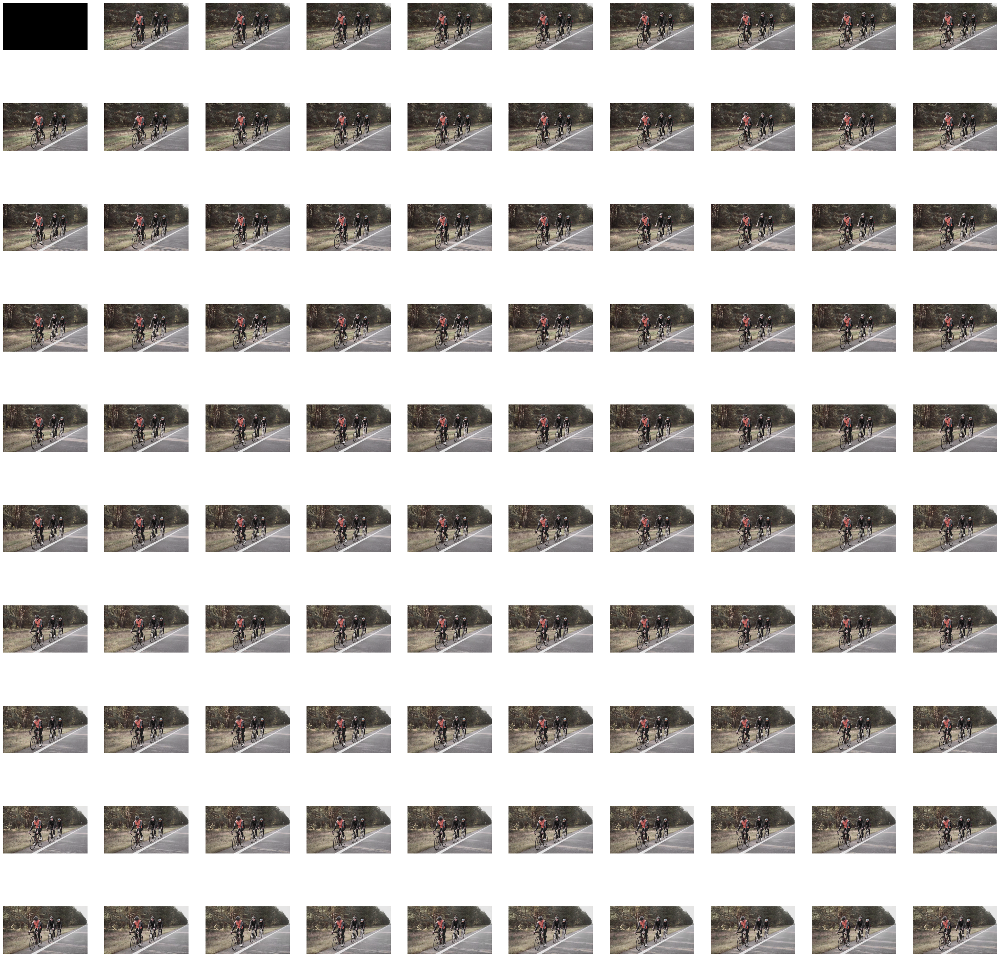

In [ ]:
# @title Dự đoán video biking
video_path = "/content/drive/MyDrive/ViT/video/biking01_1080p.mp4"
# load model đã finetuned và đã được up ở hugging face https://huggingface.co/phungtuhieu/vit_finetuning01
model_path = "phungtuhieu/vit_finetuning01"
frame_rate = 30
predict_video(video_path, model_path, frame_rate)

Predicting: 100%|██████████| 419/419 [05:14<00:00,  1.33it/s]



Predictions for all classes:
	Class: biking, Probability: 0.00%
	Class: soccer_juggling, Probability: 100.00%
	Class: volleyball_spiking, Probability: 0.00%

--> Final label of the video: soccer_juggling, Probability: 100.00%



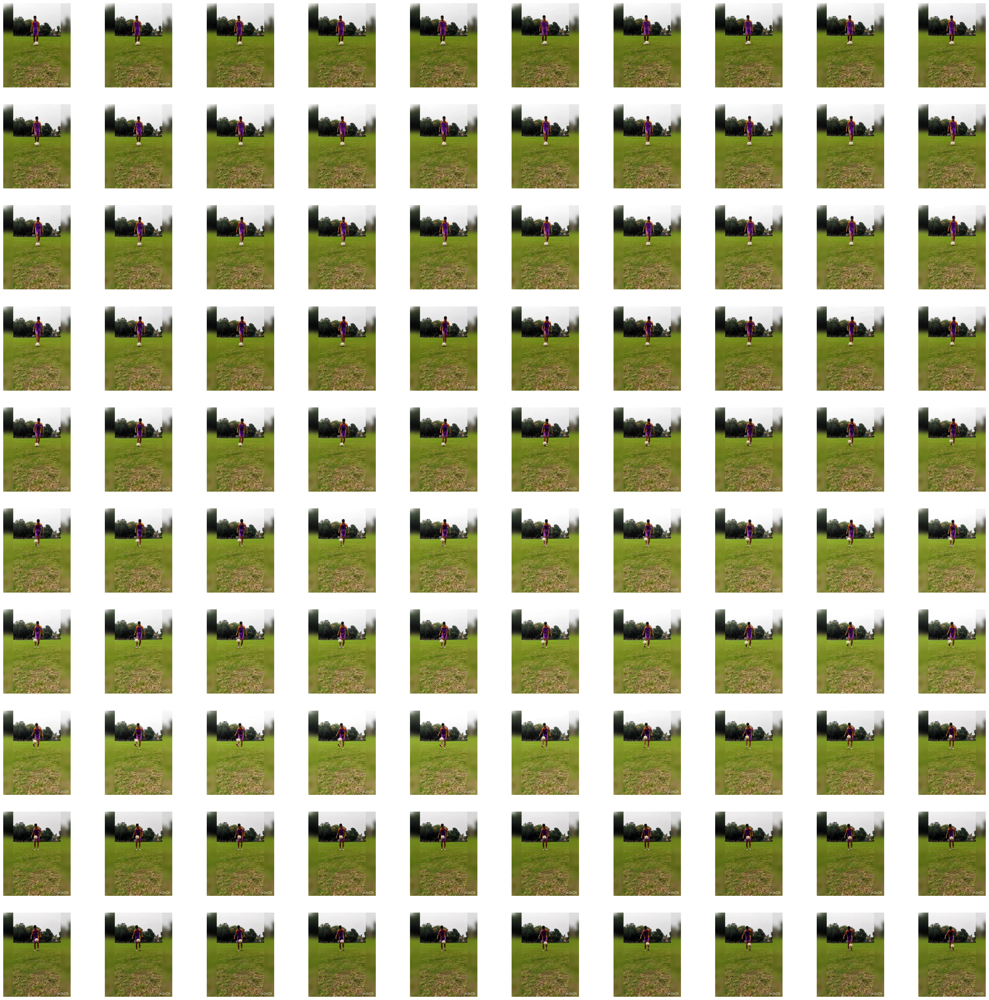

In [ ]:
# @title Dự đoán video soccer juggling
video_path = "/content/drive/MyDrive/ViT/video/football juggling1080p.mp4"
model_path = "phungtuhieu/vit_finetuning01"
frame_rate = 30
predict_video(video_path, model_path, frame_rate)

Predicting: 100%|██████████| 292/292 [03:17<00:00,  1.48it/s]



Predictions for all classes:
	Class: biking, Probability: 0.00%
	Class: soccer_juggling, Probability: 0.02%
	Class: volleyball_spiking, Probability: 99.98%

--> Final label of the video: volleyball_spiking, Probability: 99.98%



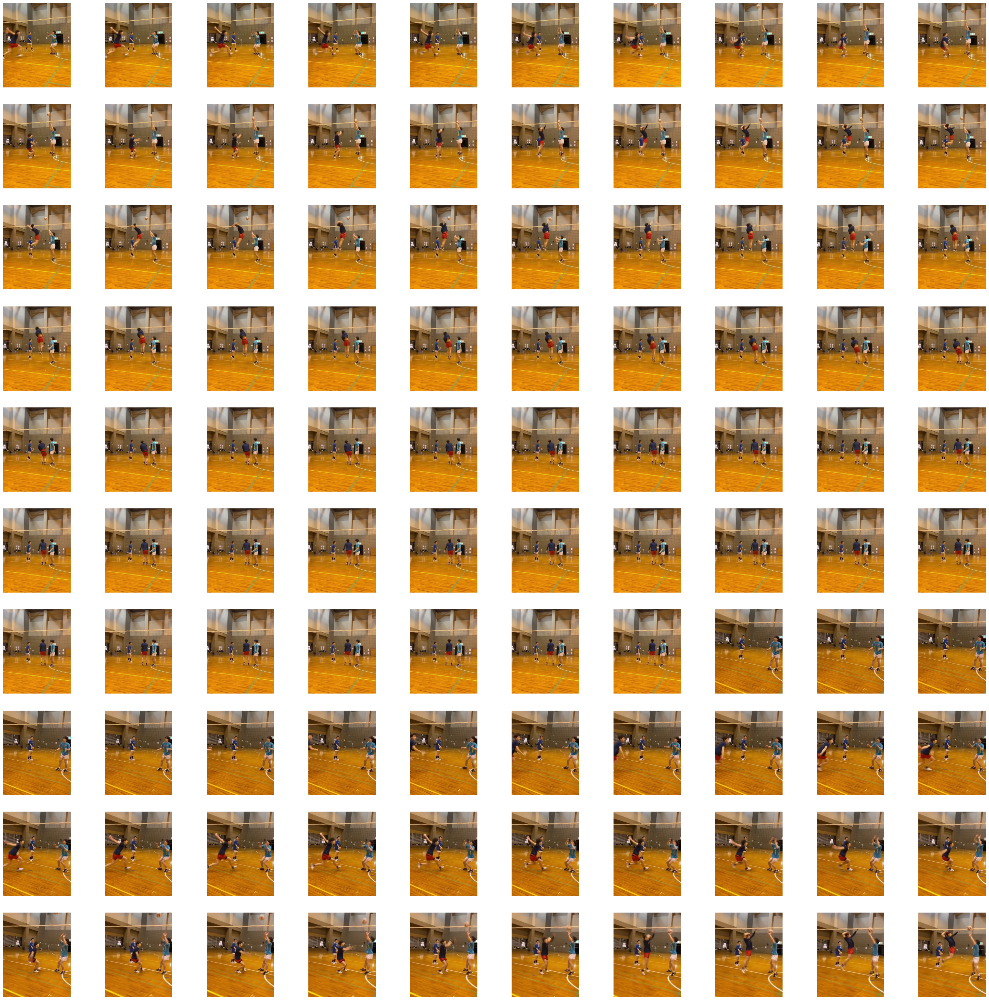

In [ ]:
# @title Dự đoán video volleyball spiking
video_path = "/content/drive/MyDrive/ViT/video/volleyball training Spike🏐🔥.mp4"
model_path = "phungtuhieu/vit_finetuning01"
frame_rate = 30
predict_video(video_path, model_path, frame_rate)